# COVID-19 - Kaggle Textos

- Link para o desafio: https://www.kaggle.com/allen-institute-for-ai/CORD-19-research-challenge
- Call to action: https://www.whitehouse.gov/briefings-statements/call-action-tech-community-new-machine-readable-covid-19-dataset/

## Instalação e importação das bibliotecas

In [1]:
#!pip install spacy
#!pip install scispacy
#!pip install wget
#!pip install wordcloud

In [2]:
#!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.2.4/en_core_sci_md-0.2.4.tar.gz

In [3]:
#!python -m spacy download en

In [4]:
import glob
import wget
import json
import nltk
import spacy
import zipfile
import scispacy
import numpy as np
import pandas as pd
import seaborn as sns
import en_core_sci_md
from matplotlib import pyplot as plt
from IPython.core.display import HTML

## Obter o dataset

Download do zip 
https://drive.google.com/file/d/1KwqHUm_gxTaeeGkOx5QmAqTGClcD54-F/view?usp=sharing

Salvar na pasta /dataset/

In [5]:
file = './datasets/CORD-19-research-challenge.zip'
zip_object = zipfile.ZipFile(file=file, mode='r')
zip_object.extractall('./datasets/CovidChallenge')
zip_object.close()

## Criação do dataframe com os textos

In [6]:
corona_features = {'paper_id': [], 'title': [], 'abstract': [], 'text': []}

In [7]:
type(corona_features)

dict

In [8]:
corona_df = pd.DataFrame.from_dict(corona_features)

In [9]:
type(corona_df)

pandas.core.frame.DataFrame

In [10]:
corona_df.head()

,paper_id,title,abstract,text


In [11]:
json_filenames = glob.glob(f'{"."}//**/*.json', recursive = True)

In [12]:
print(json_filenames)

ts/CovidChallenge/comm_use_subset/comm_use_subset/f635dd0f13ee3859c7e4b653398c9b9dba9895d8.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/3b5ea760c63aaff964de32541643d92c69dfc05e.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/b298992d7feb9dd3d23192572f975abdf2cebc0a.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/c4fc28f1a66e4664a3dc12f5b121ee97aa9f122d.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/8086b478a036f07fc6a809c63dc7d52acb659fe1.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/d9c9f9f03cb93fd7ddd3f409d8948f0ecf30445e.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/d887a0239eb93e1f9eed94d50126ba28157c4675.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/4db3931c4b24ae432d68b7e24f593b1272445523.json', './datasets/CovidChallenge/comm_use_subset/comm_use_subset/2cbcfb658251f2d2873e1ec118deea4167283c0a.json', './datasets/CovidChallenge/comm_use_subset/com

In [13]:
len(json_filenames)

29315

In [14]:
def return_corona_df(json_filenames, df):
  for file_name in json_filenames:
    row = {'paper_id': None, 'title': None,
           'abstract': None, 'text': None}
    
    with open(file_name) as json_data:
      if file_name == './sample_data/anscombe.json':
        continue

      data = json.load(json_data)

      row['paper_id'] = data['paper_id'].strip() # ' 345 ' -> '345'
      row['title'] = data['metadata']['title'].strip()

      abstract_list = [abstract['text'] for abstract in data['abstract']]
      abstract = '\n '.join(abstract_list)
      row['abstract'] = abstract.strip()

      text_list = [text['text'] for text in data['body_text']]
      text = '\n '.join(text_list)
      row['text'] = text.strip()

      df = df.append(row, ignore_index = True)
  return df

In [15]:
corona_df = return_corona_df(json_filenames, corona_df)
corona_df.to_csv('./datasets/corona_df_completo.csv')

In [16]:
corona_df.shape

(29315, 4)

In [17]:
corona_df.head()

,paper_id,title,abstract,text
0,20ed8dec93910bbe5223429edd47b37af9fab9ce,Travel implications of emerging coronaviruses:...,The emergence of Severe Acute Respiratory Synd...,aroused widespread fear and concern for their ...
1,d4ba4eaec59274c79ba7eebce7b6c3351827a017,Some remarks on protein attribute prediction a...,With the accomplishment of human genome sequen...,are very important to both basic research and ...
2,c3eb109ffe98e831469def541c8a056eb0b54bae,Understanding the alphaviruses: Recent researc...,,The VIIIth edition of the International Commit...
3,01b9cff3de8b775f53a16d643be1759374faa4df,,Background: Influenza acts synergistically wit...,Severe influenza Influenza A (H1N1) pdm09 Co-i...
4,cd13619d9957bce4f97bda11f58fda9c3bad2e64,,mortality and morbidity. The use of sulfonamid...,To the Editor:\n It has been shown that printe...


In [18]:
corona_df['text']

0        aroused widespread fear and concern for their ...
1        are very important to both basic research and ...
2        The VIIIth edition of the International Commit...
3        Severe influenza Influenza A (H1N1) pdm09 Co-i...
4        To the Editor:\n It has been shown that printe...
                               ...                        
29310    Frameshifting on dnaX variants with mutations ...
29311    We need only to look at the size and growth of...
29312    As outbreaks emerge, public health agencies of...
29313    Worldwide, there are reportedly about 12 milli...
29314    The usage of hospital isolation rooms has been...
Name: text, Length: 29315, dtype: object

In [19]:
len(corona_df['text'])

29315

# Pré-processamento



## Valores faltantes

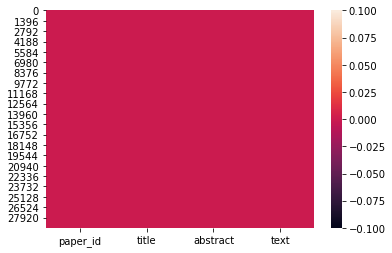

In [20]:
sns.heatmap(corona_df.isnull());

In [21]:
corona_df.shape

(29315, 4)

In [22]:
len(corona_df[corona_df['paper_id'] == ''])

0

In [23]:
len(corona_df[corona_df['title'] == ''])

3583

In [24]:
len(corona_df[corona_df['abstract'] == ''])

8051

In [25]:
len(corona_df[corona_df['text'] == ''])

0

In [26]:
corona_df = corona_df[corona_df['title'] != '']

In [27]:
corona_df = corona_df[corona_df['abstract'] != '']

In [28]:
corona_df.shape

(20343, 4)

## Valores duplicados

In [29]:
corona_df.drop_duplicates(['abstract', 'text', 'title'], inplace = True)

In [30]:
corona_df.shape

(20211, 4)

## Amostra da base de dados

In [31]:
corona_df = corona_df.sample(n = 500, random_state=1)

In [32]:
corona_df.shape

(500, 4)

In [33]:
corona_df.head()

,paper_id,title,abstract,text
11219,63ce8dc2b5abe467ae29a0a9dbebc8beb8eccf63,Controlling a possible outbreak of Candida aur...,C. auris was first isolated from the ear of a ...,The first mobile phones became commercially av...
13708,c6ef7b36318bd1baf0f3a6638ef571b755d8cfd6,Murine sarcoma virus transformation of BALB/3T...,"publicly funded repositories, such as the WHO ...",mosquito Culex tarsalis with Plasmodium relict...
1512,d1e0228ef0cb1dbaeca8ac648711febb4921d450,"Robots, pipelines, polyproteins: Enabling mult...",Multiprotein complexes catalyze vital biologic...,The structural proteomics initiative SPINE (St...
11663,f7eac9466807a50cfa24455c4a8b79bbf8c3510a,Confl ict and Emerging Infectious Diseases,Detection and control of emerging infectious d...,A n emerging infectious disease is one that is...
1053,d0067a3d2448fee1313c821e9638d0ee542336a9,Variation of the sequence in the gene encoding...,A nucleotide variability in the sequence of th...,"loss of appetite, lethargy, and occasionally s..."


In [34]:
corona_df.tail()

,paper_id,title,abstract,text
25047,989be59a0cd5354610ff80be6e50fa6617c077bf,Protective Role of the ACE2/Ang-(1-9) Axis in ...,Despite reduction in cardiovascular (CV) event...,All epidemiological studies show that the risk...
243,d9b7e741f8d18d39308f908ac84b30b8434e8476,The Veterinary Journal,The main source of Leishmania infantum infecti...,Visceral leishmaniasis (VL) is a zoonosis caus...
23772,ca5775b18f2a5c86fc3efd929ef997a189fd1705,A dual controllability analysis of influenza v...,Background: Host factors of influenza virus re...,The development of computational methods to id...
22743,8f4aac04423c7ebb955c7f006665728fe95f1498,High-level expression of the HIV entry inhibit...,Key message The potent anti-HIV microbicide gr...,The global human immunodeficiency virus (HIV) ...
23678,6b5de60d9f674c951315c0c7549fe9e9987e239f,Adenovirus serotype 7 associated with a severe...,Background: Pneumonia caused by adenovirus inf...,Human adenoviruses cause a wide spectrum of di...


In [35]:
sample_text = corona_df['text'][243]
sample_text

ary School were used to analyse the CBC results.\n Total IgG T , IgG 1 and IgG 2 serum concentrations were detected using a technique modified from that of Voller et al. (1979) . The antigen was produced from cultured promastigotes of L. infantum strain MHOM/BR/1967/ BH46, previously ruptured by ultrasound (40 x) and centrifuged at 150 g for 10 min. Individual wells of a 96-well microplate were coated with soluble antigen at a final concentration of 2 lg/mL in 0.05 M carbonate buffer (pH 9.6). A volume of 100 lL per well was left overnight at 4°C and then washed five times in phosphate buffered saline (PBS) containing 0.2% Tween-20. Antigenic sites were saturated for 30 min at 37°C with 150 lL PBS containing 0.2% Tween-20 and 2% casein (Sigma; C0376).\n The wells were washed again three times with PBS containing 0.2% Tween-20 and 100 lL per well of dog sera diluted 1:400 for detection of IgG T and IgG subclasses. After incubation for 45 min at 37°C, the plates were washed five times, f

## Função para pré-processamento

In [36]:
nlp = en_core_sci_md.load(disable=['tagger', 'parser', 'ner'])
nlp.max_length = 2000000

In [37]:
print(spacy.lang.en.stop_words.STOP_WORDS)

{'noone', 'could', 'never', 'we', 'always', 'used', 'she', 'amount', 'meanwhile', 'thereafter', 'and', 'he', 'although', 'his', 'still', 'several', 'latter', 'please', 'other', 'herself', 'twenty', 'n’t', 'itself', '’ll', 'their', 'because', 'six', 'her', 'four', 'except', 'if', 'at', "'re", 'were', 'whereby', 'full', 'sometimes', 'my', 'else', 'not', 'seem', 'no', 'on', 'even', 'wherein', 'beside', 'was', 'least', 'serious', '‘re', 'something', 'anyway', '‘ll', 'nothing', 'few', 'i', 'alone', 'beyond', '‘d', 'being', 'very', 'whatever', 'hence', 'regarding', '’s', 'somewhere', 'thru', '’d', 'yourself', 'yourselves', 'anyone', 'why', 'elsewhere', 'to', 'which', 'does', 'therein', 'take', '‘m', 'beforehand', 'once', 'ca', 'almost', 'whither', 'is', 'none', 'since', 'would', 'make', 'toward', 'using', 'am', "'ve", 're', 'while', 'before', 'from', '‘s', 'whom', 'every', 'myself', 'everywhere', 'throughout', 'within', "'d", 'yet', 'after', 'thence', 'out', 'into', 'that', 'made', 'by', 'so

In [38]:
len(spacy.lang.en.stop_words.STOP_WORDS)

326

In [39]:
new_stop_words = ['et', 'al', 'doi', 'copyright', 'http', 'https', 'fig', 'table', 'result', 'show']
for word in new_stop_words:
  nlp.vocab[word].is_stop = True

In [40]:
def spacy_tokenizer(sentence):
  sentence = sentence.lower()
  list = []
  list = [word.lemma_ for word in nlp(sentence) if not (word.is_stop or
                                                        word.like_num or
                                                        word.is_punct or
                                                        word.is_space or
                                                        len(word) == 1)]
  list = ' '.join([str(element) for element in list])

  return list

In [41]:
sample_text

ary School were used to analyse the CBC results.\n Total IgG T , IgG 1 and IgG 2 serum concentrations were detected using a technique modified from that of Voller et al. (1979) . The antigen was produced from cultured promastigotes of L. infantum strain MHOM/BR/1967/ BH46, previously ruptured by ultrasound (40 x) and centrifuged at 150 g for 10 min. Individual wells of a 96-well microplate were coated with soluble antigen at a final concentration of 2 lg/mL in 0.05 M carbonate buffer (pH 9.6). A volume of 100 lL per well was left overnight at 4°C and then washed five times in phosphate buffered saline (PBS) containing 0.2% Tween-20. Antigenic sites were saturated for 30 min at 37°C with 150 lL PBS containing 0.2% Tween-20 and 2% casein (Sigma; C0376).\n The wells were washed again three times with PBS containing 0.2% Tween-20 and 100 lL per well of dog sera diluted 1:400 for detection of IgG T and IgG subclasses. After incubation for 45 min at 37°C, the plates were washed five times, f

In [42]:
test = '1 ' + sample_text
test

ary School were used to analyse the CBC results.\n Total IgG T , IgG 1 and IgG 2 serum concentrations were detected using a technique modified from that of Voller et al. (1979) . The antigen was produced from cultured promastigotes of L. infantum strain MHOM/BR/1967/ BH46, previously ruptured by ultrasound (40 x) and centrifuged at 150 g for 10 min. Individual wells of a 96-well microplate were coated with soluble antigen at a final concentration of 2 lg/mL in 0.05 M carbonate buffer (pH 9.6). A volume of 100 lL per well was left overnight at 4°C and then washed five times in phosphate buffered saline (PBS) containing 0.2% Tween-20. Antigenic sites were saturated for 30 min at 37°C with 150 lL PBS containing 0.2% Tween-20 and 2% casein (Sigma; C0376).\n The wells were washed again three times with PBS containing 0.2% Tween-20 and 100 lL per well of dog sera diluted 1:400 for detection of IgG T and IgG subclasses. After incubation for 45 min at 37°C, the plates were washed five times, f

In [43]:
result = spacy_tokenizer(test)
result

'visceral leishmaniasis vl zoonosis cause leishmania leishmania infantum find mediterranean area neotropics human disease region associate presence domestic dog parasite transmit phlebotomine sandfly diptera psychodidae main neotropical vector lutzomyia longipalpis lutz neiva vl important role public health brazil high incidence wide geographical distribution mark increase transmission associate urbanisation follow emergence disease opportunistic infection human immunodeficiency virus (hiv)-infected individual control measure currently base treatment human case spray house animal shelter residual insecticide cull dog identify seropositive indirect immunofluorescent antibody test ifat enzyme-linked immunosorbent assay elisas measure represent permanent solution new vl focus continue appear country urban area domestic dog main reservoir l. infantum canine vl associate human case disease acquire sandfly infect feed infect animal subsequent blood meal human moreno alvar infect dog present 

In [44]:
corona_df['text'] = corona_df['text'].apply(spacy_tokenizer)

In [45]:
print(sample_text)

thology Laboratory of the Veterinary School were used to analyse the CBC results.
 Total IgG T , IgG 1 and IgG 2 serum concentrations were detected using a technique modified from that of Voller et al. (1979) . The antigen was produced from cultured promastigotes of L. infantum strain MHOM/BR/1967/ BH46, previously ruptured by ultrasound (40 x) and centrifuged at 150 g for 10 min. Individual wells of a 96-well microplate were coated with soluble antigen at a final concentration of 2 lg/mL in 0.05 M carbonate buffer (pH 9.6). A volume of 100 lL per well was left overnight at 4°C and then washed five times in phosphate buffered saline (PBS) containing 0.2% Tween-20. Antigenic sites were saturated for 30 min at 37°C with 150 lL PBS containing 0.2% Tween-20 and 2% casein (Sigma; C0376).
 The wells were washed again three times with PBS containing 0.2% Tween-20 and 100 lL per well of dog sera diluted 1:400 for detection of IgG T and IgG subclasses. After incubation for 45 min at 37°C, the p

In [46]:
len(sample_text)

27624

In [47]:
print(corona_df['text'][243])

visceral leishmaniasis vl zoonosis cause leishmania leishmania infantum find mediterranean area neotropics human disease region associate presence domestic dog parasite transmit phlebotomine sandfly diptera psychodidae main neotropical vector lutzomyia longipalpis lutz neiva vl important role public health brazil high incidence wide geographical distribution mark increase transmission associate urbanisation follow emergence disease opportunistic infection human immunodeficiency virus (hiv)-infected individual control measure currently base treatment human case spray house animal shelter residual insecticide cull dog identify seropositive indirect immunofluorescent antibody test ifat enzyme-linked immunosorbent assay elisas measure represent permanent solution new vl focus continue appear country urban area domestic dog main reservoir l. infantum canine vl associate human case disease acquire sandfly infect feed infect animal subsequent blood meal human moreno alvar infect dog present w

In [48]:
len(corona_df['text'][243])

17480

# Termos frequentes

In [49]:
if not os.path.exists('./datasets/corpus'):
    os.makedirs('./datasets/corpus')

In [50]:
for index, row in corona_df.iterrows():
  print(row['paper_id'], row['title'])
  file = './datasets/corpus/' + row['paper_id'] + '.txt'
  
  with open(file, 'w', encoding='utf-8') as f:
    f.write(row['text'])

streams
31fa7844fdceee15b185eb734a7e1a09527431e2 High-Resolution Analysis of Coronavirus Gene Expression by RNA Sequencing and Ribosome Profiling
37618db734bfa87cf54a9562ad2c6fd884471791 Dengue Virus Perturbs Mitochondrial Morphodynamics to Dampen Innate Immune Responses Article Dengue Virus Perturbs Mitochondrial Morphodynamics to Dampen Innate Immune Responses
b561d50b679042ab49a9084894c842ddd66981f3 What Factors Predispose Patients to Acute Respiratory Distress Syndrome?
9b7ef48004d518c358e6bf672a7242d01451b7ea A longitudinal study of the dynamics of bovine corona virus and respiratory syncytial virus infections in dairy herds
0e55f6bd5bc4ae31e51945e528e8cad9f4f34f76 EFFECTS OF PSEUDORABIES VIRUS INFECTION UPON CYTOTOXICITY AND ANTIVIRAL ACTIVITIES OF PORCINE ALVEOLAR MACROPHAGES
6b3f7521b0b4ed6a0230e0ce6ab2f4c02892a287 Epidemiology of virus-induced asthma exacerbations: with special reference to the role of human rhinovirus
f242eacde1d5ea31807b3d74b4febf86c729764e Contact tracing w

In [51]:
from nltk.corpus import PlaintextCorpusReader
corpus = PlaintextCorpusReader('./datasets/corpus', '.*')

In [52]:
files = corpus.fileids()

In [53]:
files[0]

'00799d9acb7f964564fd4c31d0e6268185e68e3c.txt'

In [54]:
corpus.raw('00799d9acb7f964564fd4c31d0e6268185e68e3c.txt')

'porcine epidemic diarrhea virus pedv swine coronavirus attack gastrointestinal tract cause destruction villous enterocytes villous atrophy jejunum ileum result induce watery diarrhea ducatelle al. virus pathologically similar swine coronavirus transmissible gastroenteritis virus tgev make difficult differentiate base clinical symptom pritchard al. pedv discover rapidly spread europe part asia incidence ped outbreak europe diminish significantly remain important viral pathogen swine asian country pensaert korea seasonal outbreak result high mortality neonatal piglet weight loss fatten pig cause economic loss swine industry chae al. economic importance pedv celladapted strain virus develope candidate live attenuate vaccine kweon al. song al. park al. development vaccine candidate focus co-26k fragment equivalent coe domain find spike protein report contain neutralize epitope pedv chang al. kang al. recently b-cell epitope report induce neutralize antibody pedv cruz al. epitope character

In [55]:
words = corpus.words()
print(words)

['porcine', 'epidemic', 'diarrhea', 'virus', 'pedv', ...]


In [56]:
len(words)

1637567

In [57]:
frequency = nltk.FreqDist(words)
most_common = frequency.most_common(100)
most_common

[('-', 65585),
 ('.', 23416),
 ('cell', 13124),
 ('di', 11853),
 ('/', 10732),
 ('virus', 8286),
 ('protein', 8213),
 ('al', 8102),
 ('study', 6691),
 ("'", 6268),
 ('infection', 6168),
 ('show', 4825),
 ('il', 4785),
 ('la', 4666),
 ('high', 4118),
 ('viral', 4066),
 ('1', 3943),
 ('l', 3713),
 ('disease', 3705),
 ('sample', 3622),
 ('gene', 3596),
 ('result', 3589),
 ('patient', 3499),
 ('sequence', 3498),
 ('mouse', 3460),
 ('human', 3420),
 ('increase', 3383),
 ('fig', 3356),
 ('time', 3317),
 ('level', 3313),
 ('group', 3251),
 ('control', 3213),
 ('include', 3193),
 ('datum', 3168),
 ('figure', 3135),
 ('expression', 3116),
 ('test', 2998),
 ('analysis', 2967),
 ('model', 2939),
 ('report', 2928),
 ('rna', 2927),
 ('antibody', 2853),
 ('effect', 2802),
 ('case', 2712),
 ('day', 2712),
 ('different', 2640),
 ('response', 2628),
 ('un', 2584),
 ('system', 2572),
 ('find', 2483),
 ('non', 2422),
 ('del', 2422),
 ('low', 2401),
 ('activity', 2379),
 ('infect', 2367),
 ('bind', 2359),

# Nuvem de palavras

In [58]:
from matplotlib.colors import ListedColormap
color_map = ListedColormap(['orange', 'green', 'red', 'magenta'])

In [59]:
from wordcloud import WordCloud
cloud = WordCloud(background_color = 'white', max_words=100, colormap=color_map)

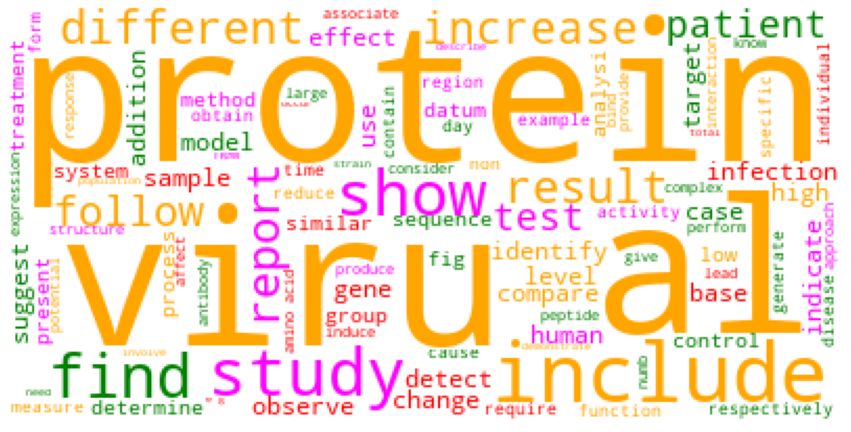

In [60]:
cloud = cloud.generate(corona_df['text'].str.cat(sep='\n'))
plt.figure(figsize=(15,15))
plt.imshow(cloud)
plt.axis('off')
plt.show()

In [61]:
corona_df.to_csv('./datasets/corona_df.csv')

# Extração de entidades nomeadas

## Testes com a função

In [62]:
text = str(corona_df['text'][243])
print(text)

visceral leishmaniasis vl zoonosis cause leishmania leishmania infantum find mediterranean area neotropics human disease region associate presence domestic dog parasite transmit phlebotomine sandfly diptera psychodidae main neotropical vector lutzomyia longipalpis lutz neiva vl important role public health brazil high incidence wide geographical distribution mark increase transmission associate urbanisation follow emergence disease opportunistic infection human immunodeficiency virus (hiv)-infected individual control measure currently base treatment human case spray house animal shelter residual insecticide cull dog identify seropositive indirect immunofluorescent antibody test ifat enzyme-linked immunosorbent assay elisas measure represent permanent solution new vl focus continue appear country urban area domestic dog main reservoir l. infantum canine vl associate human case disease acquire sandfly infect feed infect animal subsequent blood meal human moreno alvar infect dog present w

In [63]:
nlp_ent = spacy.load('en')
nlp_ent.max_length = 2000000

In [64]:
doc = nlp_ent(text)

In [65]:
for entity in doc.ents:
  if entity.label_ == 'NORP' or entity.label_ == 'GPE':
    print(entity.text, entity.label_)

leishmania leishmania GPE
brazil GPE
hypoplasia GPE
amusategui al GPE
gradoni NORP
belo horizonte GPE
brazilian NORP
tween-20 NORP
tween-20 NORP
brazilian NORP
piauí GPE
neutrophil GPE
anaemia dog present NORP
amusategui al GPE
thrombocytopenia GPE


In [66]:
from spacy import displacy
displacy.render(doc, style = 'ent', jupyter = True)

## Contagem das entidades na base de dados

In [67]:
gpe = []
for index, row in corona_df.iterrows():
  text = row['text']
  doc = nlp_ent(text)
  for entity in doc.ents:
    if entity.label_ == 'GPE':
      gpe.append(str(entity.text))

In [68]:
print(gpe)

rna', 'abrin', 'encode profilin', 'qcdc', 'switzerland', 'profilin', 'qcdc', 'profilin profilin', 'qcdc', 'intestinal jejunum increase', 'profilin profilin', 'qcdc', 'qcdc', 'qcdc', 'qcdc', 'profilin', 'qcdc', 'qcdc', 'qcdc', 'qcdc', 'th1 cytokine profilin', 'th1', 'fiji', 'fiji', 'fiji', 'fiji', 'fiji', 'fiji', 'new zealand', 'link beach', 'australia', 'new zealand', 'fiji', 'fiji', 'fiji', 'fiji', 'fiji', 'al', 'strand', 'fiji', 'fiji', 'fiji', 'sand beach hoegh-guldberg al.', 'fiji', 'singapore', 'australia', 'new zealand', 'suva', 'fiji', 'f$', 'new zealand', 'new zealand', 'fiji', 'comm', 'comm', 'mamanuca island', 'fiji', 'comm', 'treasure island', 'comm', 'comm', 'comm', 'uptake', 'comm', 'fiji', 'comm', 'fiji', 'ayala', 'fiji', 'fiji', 'fiji', 'fiji', 'fiji', 'comm', 'thailand', 'fiji', 'germany', 'japan', 'pittsburgh', 'china', 'fuyang anhui', 'china', 'encode', 'encode', 'mrna', 'mrna', 'mrna', 'mrna', 'ube6e', 'sirna', 'sirna', 'ubc6e−/−', 'sirna', 'ubc6e−/−', 'homeostasis',

In [69]:
values_gpe, counts_gpe = np.unique(np.array(gpe), return_counts = True)

In [70]:
gpe_df = pd.DataFrame({'value': values_gpe, 'counts': counts_gpe})

In [71]:
gpe_df.head()

,value,counts
0,-)-microcionin-1,1
1,-70~c,1
2,-adattamento,1
3,-biotin,1
4,"-dioctadecyl-3,3,3",1


In [72]:
gpe_df.shape

(2631, 2)

In [73]:
gpe_df_filtered = gpe_df[gpe_df.counts > 50]

In [74]:
gpe_df_filtered.shape

(26, 2)

In [75]:
gpe_df_filtered

,value,counts
281,beijing,67
309,brazil,55
345,canada,108
399,china,636
584,delle,257
860,germany,153
972,hong kong,325
1033,il,134
1061,india,60
1116,italy,62


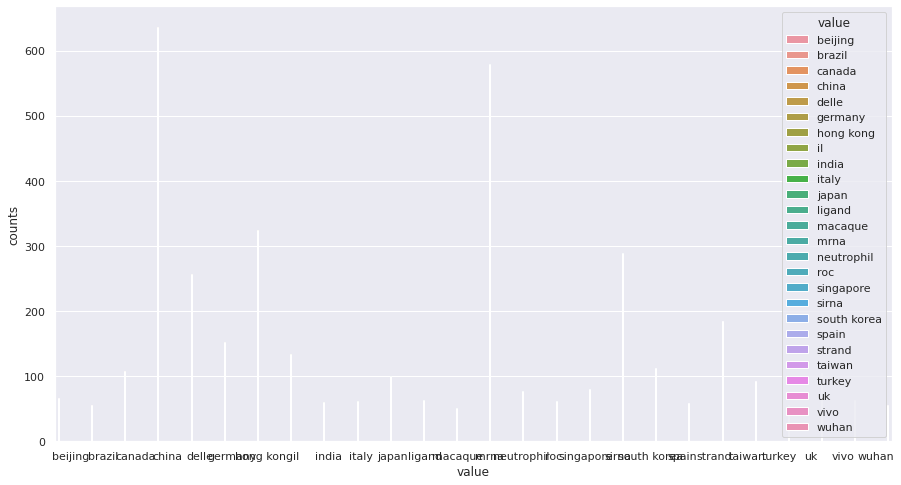

In [76]:
sns.set(rc={'figure.figsize': (15,8)})
sns.barplot(x = 'value', y = 'counts', hue='value', data=gpe_df_filtered);

# Textos utilizados para pesquisa

## What do we know about COVID-19 risk factors?

- Smoking, 
- pre-existing pulmonary disease
- Co-infections (determine whether co-existing respiratory/viral infections make the virus more transmissible or virulent) and other - co-morbidities
- Neonates and pregnant women
- Socio-economic and behavioral factors to understand the economic impact of the virus and whether there were differences

## What do we know about non-pharmaceutical interventions?

- Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases.
Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.




# Pesquisa com uma palavra e NLTK

In [77]:
text = nltk.Text(corpus.words())

In [78]:
match = text.concordance('pulmonary', width = 150, lines=30)

Displaying 30 of 255 matches:
ge diagnostic gene allow detect nsclc distinguish chronic obstructive pulmonary disease level snord33 snord66 snord76 reflect stage malignancy histol
espiratory disease p & i pneumonia influenza copd chronic obstructive pulmonary disease ihd ischemic heart disease effect influenza occasionally exhi
umonia influenza p & i icd - 9 icd - 10 j10 - j18 chronic obstructive pulmonary disease copd icd - 9 icd - 10 j40 - j47 ischemic heart disease ihd ic
espiratory disease p & i pneumonia influenza copd chronic obstructive pulmonary disease ihd ischemic heart disease annual death rate attributable inf
γ production control infectious complication stroke γδ cell essential pulmonary bacterial clearance αβt cell critical peripheral blood stroke induce 
me coronavirus papain - like protease show induce tgf - β1 - mediated pulmonary fibrosis activation reactive oxygen species ( ros )/ p38 mapk / stat3
andidate drug figure 5a associate hcovs clinical study show potential 

In [79]:
type(match)

NoneType

# Pesquisa com uma palavra e "find"

## Testando o método "find"

In [80]:
string = 'spread wuhan city china infect traveller cause sporadic secondary transmission city secondary city epidemic'
search_string = 'city'

In [81]:
print(string.find(search_string))

13


In [82]:
string[13]

'c'

In [83]:
string[13:13+10]

'city china'

In [84]:
string[13-10:13]

'ead wuhan '

In [85]:
string[13:13+10000]

'city china infect traveller cause sporadic secondary transmission city secondary city epidemic'

In [86]:
# Código baseado em: https://www.journaldev.com/23666/python-string-find
def find_texts(input_str, search_str, number_of_words):
  l = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return l
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    l.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return l

In [87]:
texts = find_texts(string, search_string, 50)
texts

['spread wuhan city china infect traveller cause sporadic seconda',
 't traveller cause sporadic secondary transmission city secondary city epidemic',
 'se sporadic secondary transmission city secondary city epidemic']

In [88]:
display(HTML(f'<h1>{search_string.upper()}</h1>'))
display(HTML(f"""<p><strong>Number of matches:</strong> {len(texts)}</p>"""))
for i in texts:
  #print(i)
  marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
  #print(marked_text)
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

## Aplicação na base de dados

In [89]:
search_string = 'pulmonary disease'

In [90]:
search_string = spacy_tokenizer(search_string)
search_string

'pulmonary disease'

In [91]:
def find_all_texts(input_str, search_str, number_of_words):
  text_list = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return text_list
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    text_list.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return text_list

In [92]:
documents = []
for index, row in corona_df.iterrows():
  documents.append(find_all_texts(row['text'], search_string, 40))

In [93]:
len(documents)

500

In [94]:
for doc in documents:
  if doc != []:
    print(doc)

['erculosis present typical manifestation pulmonary disease common presentation tu', ' phase study give table patient advance pulmonary disease present cough fever we', 'collection process patient tuberculosis pulmonary disease majority control respi']
['t nsclc distinguish chronic obstructive pulmonary disease level snord33 snord66 ']
['onia influenza copd chronic obstructive pulmonary disease ihd ischemic heart dis', 'cd-9 icd-10 j10-j18 chronic obstructive pulmonary disease copd icd-9 icd-10 j40-', 'onia influenza copd chronic obstructive pulmonary disease ihd ischemic heart dis']
['cent study suggest chronic inflammatory pulmonary disease emphysema highly assoc']
['ctious cause asthma chronic obstructive pulmonary disease interstitial lung dise']
['m follow-up patient chronic obstructive pulmonary disease copd survivor acute re', 'lt low sf-36 score appear predominately pulmonary disease great impact physical ']
[' influenza sars pneumonia gastric ulcer pulmonary disease numerous n

In [95]:
for index, row in corona_df.iterrows():
  texts = find_all_texts(row['text'], search_string, 400)
  if texts == []:
    continue
  
  paper_id = row['paper_id']
  title = row['title']
  display(HTML(f'<h1>{search_string.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(texts)}
                   </p>"""))
  for i in texts:
    marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
    display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))  


Vantagens
- Rápido
- Fácil implementação
- Muito útil para pesquisas simples com uma palavra
- Bom para palavras-chave

Desvantagens
- Somente uma palavra-chave
- Não possui ordenação de importância
- Considera somente a palavra "completa"

# Pesquisa com mais palavras e spaCy

## Testando o spaCy

In [96]:
string = 'spread wuhan city china infect traveller cause sporadic secondary transmission city secondary city epidemic'

In [97]:
search_strings = ['city', 'traveller']
tokens_list = [nlp(item) for item in search_strings]

In [98]:
tokens_list

[city, traveller]

In [99]:
print(nlp.vocab)

In [100]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)

In [101]:
doc = nlp(string)
matches = matcher(doc)
matches

[(8661325627334373315, 2, 3),
 (8661325627334373315, 5, 6),
 (8661325627334373315, 10, 11),
 (8661325627334373315, 12, 13)]

In [102]:
doc[2:3]

city

In [103]:
doc[5:6]

traveller

In [104]:
doc[10:11]

city

In [105]:
doc[12:13]

city

In [106]:
doc[10-5:10+5]

traveller cause sporadic secondary transmission city secondary city epidemic

In [107]:
matches[0]

(8661325627334373315, 2, 3)

In [108]:
matches[0][1]

2

In [109]:
matches[0][2]

3

In [110]:
doc[matches[0][1]:matches[0][2]]

city

## Aplicação na base de dados

In [111]:
search_strings = ['smoking', 'pulmonary disease']
tokens_list = [nlp(spacy_tokenizer(item)) for item in search_strings]
tokens_list

[smoke, pulmonary disease]

In [112]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)
number_of_words = 50

In [113]:
search_strings_html = ' '.join([str(element) for element in search_strings])
search_strings_html

'smoking pulmonary disease'

In [114]:
for index, row in corona_df.iterrows():
  marked_text = ''
  doc = nlp(row['text'])
  paper_id = row['paper_id']
  title = row['title']
  matches = matcher(doc)
  if matches == []:
    continue

  display(HTML(f'<h1>{search_strings_html.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(matches)}
                   </p>"""))
  for i in matches:
    start = i[1] - number_of_words
    if start < 0:
      start = 0
    for j in range(len(tokens_list)):
      if doc[i[1]:i[2]].similarity(tokens_list[j]) == 1.0:
        search_text = str(tokens_list[j])
        marked_text += str(doc[start:i[2] + number_of_words]).replace(search_text, f"<mark>{search_text}</mark>")
        marked_text += "<br /><br />"
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

Vantagens
- Fácil implementação
- Muito útil para pesquisas simples com mais palavras
- Bom para palavras-chave
- Usa uma biblioteca própria para processamento de linguagem natural

Desvantagens
- Não possui ordenação de importância

# Similaridade entre strings com fuzzywuzzy

- Distância Levenshtein: https://pt.wikipedia.org/wiki/Dist%C3%A2ncia_Levenshtein

## Testes com o fuzzywuzzy

In [115]:
!pip install fuzzywuzzy

You should consider upgrading via the '/home/angelico/anaconda3/bin/python -m pip install --upgrade pip' command.


In [116]:
!pip install python-Levenshtein

You should consider upgrading via the '/home/angelico/anaconda3/bin/python -m pip install --upgrade pip' command.


In [117]:
from fuzzywuzzy import fuzz

In [118]:
# Similaridade da string em ordem
fuzz.ratio('Apple Inc.', 'Apple')

67

In [119]:
# Similaridade da string parcial
fuzz.partial_ratio('Apple Inc.', 'Apple')

100

In [120]:
# Ignora a ordem das palavras
fuzz.token_sort_ratio('Lakers x Chigaco Bulls', 'Chigago Bulls x Lakers')

95

In [121]:
# Ignora palavras duplicadas
fuzz.token_set_ratio('Today we have a great game: Lakers x Chigago Bulls', 'Chicago Bulls x Lakers')

78

## Comparação com o texto completo

In [122]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments'

In [123]:
search_string = spacy_tokenizer(search_string)
print(search_string)

guidance way scale npis coordinate way e.g. establish fund infrastructure authority support real time authoritative qualify participant collaboration state gain consensus consistent guidance mobilize resource geographic area critical shortfall identify time enhance health care delivery system capacity respond increase case rapid design execution experiment examine compare npis currently implement dhs center excellence potentially leverage conduct experiment


In [124]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['text'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['text'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['text'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['text'], search_string))

In [125]:
len(ratio)

500

In [126]:
np.array(ratio).mean()

6.216

In [127]:
np.array(partial_ratio).mean()

44.42

In [128]:
np.array(sort_ratio).mean()

5.922

In [129]:
np.array(set_ratio).mean()

43.086

## Comparação com o abstract

In [130]:
corona_df.head()

,paper_id,title,abstract,text
11219,63ce8dc2b5abe467ae29a0a9dbebc8beb8eccf63,Controlling a possible outbreak of Candida aur...,C. auris was first isolated from the ear of a ...,mobile phone commercially available smartphone...
13708,c6ef7b36318bd1baf0f3a6638ef571b755d8cfd6,Murine sarcoma virus transformation of BALB/3T...,"publicly funded repositories, such as the WHO ...",mosquito culex tarsalis plasmodium relictum we...
1512,d1e0228ef0cb1dbaeca8ac648711febb4921d450,"Robots, pipelines, polyproteins: Enabling mult...",Multiprotein complexes catalyze vital biologic...,structural proteomics initiative spine structu...
11663,f7eac9466807a50cfa24455c4a8b79bbf8c3510a,Confl ict and Emerging Infectious Diseases,Detection and control of emerging infectious d...,emerge infectious disease newly recognize popu...
1053,d0067a3d2448fee1313c821e9638d0ee542336a9,Variation of the sequence in the gene encoding...,A nucleotide variability in the sequence of th...,loss appetite lethargy occasionally sudden dea...


In [131]:
corona_df['abstract'] = corona_df['abstract'].apply(spacy_tokenizer)

In [132]:
corona_df.head()

,paper_id,title,abstract,text
11219,63ce8dc2b5abe467ae29a0a9dbebc8beb8eccf63,Controlling a possible outbreak of Candida aur...,c. auris isolate ear japanese patient multidru...,mobile phone commercially available smartphone...
13708,c6ef7b36318bd1baf0f3a6638ef571b755d8cfd6,Murine sarcoma virus transformation of BALB/3T...,publicly fund repository covid database right ...,mosquito culex tarsalis plasmodium relictum we...
1512,d1e0228ef0cb1dbaeca8ac648711febb4921d450,"Robots, pipelines, polyproteins: Enabling mult...",multiprotein complex catalyze vital biological...,structural proteomics initiative spine structu...
11663,f7eac9466807a50cfa24455c4a8b79bbf8c3510a,Confl ict and Emerging Infectious Diseases,detection control emerge infectious disease co...,emerge infectious disease newly recognize popu...
1053,d0067a3d2448fee1313c821e9638d0ee542336a9,Variation of the sequence in the gene encoding...,nucleotide variability sequence gene encode tr...,loss appetite lethargy occasionally sudden dea...


In [133]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['abstract'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['abstract'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['abstract'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['abstract'], search_string))

In [134]:
np.array(ratio).mean()

36.094

In [135]:
np.array(partial_ratio).mean()

43.324

In [136]:
np.array(sort_ratio).mean()

36.948

In [137]:
np.array(set_ratio).mean()

42.416

## Retorno dos artigos mais similares

In [138]:
scores = {}
for index, row in corona_df.iterrows():
  scores[row['paper_id']] = fuzz.token_set_ratio(row['text'], search_string)

In [139]:
print(scores)

0c358b3caf56b8517ad61b82aca': 41, 'b75374ebf027be698e5ce4e721a4840dc4384240': 33, 'f8613e7a4718a476eb336e8ce23438d98c3f4d6e': 42, 'c93a0161a57b9a8ebcc1c6395d81ad237b38e66a': 25, 'b3487c94e4f80b43ee541b21249b1885a20f34ce': 32, 'ea91cff13aa9ef6e2f6425680b078bab260c6692': 21, '04a02b2f24ba9cf14a860a98b25f65ef2afd73fd': 61, 'c75b2dcbddee584a18274cd1f49782e4e9f2a010': 32, '4a9621e52f9d28a719b98451b665248446bc236b': 68, '92196a70fce15dd68413ea1f03e9c14b9bc9ef59': 33, '6e7be8a150296b55701950588570b7a56af1df56': 46, '0ab795fc615df6457551a8e231dce1f268eef9d2': 36, '851f1085f67a17527fa4145736c18fb1e487af75': 42, '197ea91c84908057bdd1de87abe77dd14e765d0b': 34, '255e2bd7406726ccde903239d96011c340330634': 38, 'dac3bbf26b6f5e0785092144acd855176e341d13': 34, '5a9acb16dde5abb907f6465bace23ff4e85c86f7': 43, '7f69a764a32e9fefc971d79582da33db151cdeb5': 54, 'ca70e687fe7d0471c95bc8e75b588860343fb0c6': 48, 'fff3678cfe3ce7a9ccae1e7becf17d5d71d1b54a': 28, 'e12c485164c72582c9ce504d26931efaedf3f419': 66, 'c3b1f

In [140]:
scores['b75374ebf027be698e5ce4e721a4840dc4384240']

33

In [141]:
import operator
sorted_scores = sorted(scores.items(), key=operator.itemgetter(1), reverse = True)

In [142]:
sorted_scores[0:10]

[('ce6717ad3bb0da86077a5cbb8111576ea8230b2c', 90),
 ('3518ccc719fac30ad9a95930985cb000a0018ae5', 82),
 ('d62785143ed659114805266f7c37f0ca7edebf9e', 79),
 ('a3d2ceee41401441a21947eb1bd04f0962972786', 78),
 ('31765f424318a1efd7be41fb311e54bcc00541d3', 77),
 ('34465cdee82a23962d822bcb189224e0fe4676af', 75),
 ('b1f4160623b02307f923593f0830bd5ef47e14ed', 74),
 ('384c14fbb8287badd7f0f1823ea34b6cc4ab86cb', 74),
 ('dfe23d64895beefb7e0fec49126c49d982ffe8da', 74),
 ('50f42123b5035f840369d0ff88cc55263a1394b7', 74)]

In [143]:
corona_df.loc[corona_df['paper_id'] == 'ce6717ad3bb0da86077a5cbb8111576ea8230b2c']

,paper_id,title,abstract,text
17721,ce6717ad3bb0da86077a5cbb8111576ea8230b2c,WHO's Global School Health Initiative. 1995. 4...,e8 piuttosto che articoli eccellenti termine d...,nel promuovere gestire cambiamenti necessari c...


In [144]:
pd.set_option('display.max_colwidth', -1)
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.loc[corona_df['paper_id'] == i[0]]
  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {i[0]}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'])[0:700]}
                   </p>"""))

Vantagens
- Biblioteca com várias funções
- Útil tanto para pesquisas por palavras-chave quanto para textos maiores
- Notas de acordo com a importância

Desvantagens
- Modelo de cálculo matemático não é muito adequado

# Documentos similares com TF-IDF e similaridade do cosseno

### TF-IDF (Term frequency - inverse document frequency)

- Redimensionar a frequência das palavras pela frequência com que aparecem em todos os documentos
- **Term frequency (TF)**: frequência da palavra no documento atual - TF = (número de vezes que o termo **t** aparece no documento) / (número de termos no documento)
- **Inverse document frequency (IDF)**: quão rara é a palavra nos documentos - IDF = log(N/n), **N** é o número de documentos e **n** é o número de documentos que o termo **t** apareceu
- **TF-IDF**: importância de uma palavra para um documento em uma coleção ou corpus

- Considerando um documento com 100 palavras no qual a palavra cachorro aparece 5 vezes
- TF = 5 / 100 = 0.05
- Temos 100 documentos no total (N) e a palavra cachorro aparece aparece em 20 desses documentos (n)
- IDF = log(100 / 20) = 0.69
- TF-IDF = 0.05 * 0.69 = 0.034

- Quanto maior o valor do peso, mais raro é o termo. Quanto menor o peso, mais comum é o termo

In [145]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [146]:
texts = corona_df['text'][:3].tolist()
texts

ational target modification gain activity eukaryotic expression system attract considerable interest time alternative expression e. coli currently eukaryotic expression system increasingly eukaryotic protein expression baculovirus expression vector system bevs protein production insect cell mammalian expression system protein production mammalian cell nettleship al. introduce foreign gene mammalian cell remain challenge date especially gene introduce simultaneously genetic engineer mammalian cell transgene essential contemporary biology structural biology application benefit introduce foreign gene efficiently mammalian cell reprogramme somatic cell stem cell co-expressing array specific transcription factor prominent example efficient simultaneous monitor parameter live cell fluorescent-protein sensor essential prerequisite cell biology experiment example multi-component pathway follow precisely achieve robust result experiment mammalian cell formidable task require specialist knowledg

In [147]:
texts.append(texts[0])
texts

nstruct multigene vector generation reengineer streamline multibac plasmid synthesize small donor acceptor contain baculovirus specific promoter terminator addition characteristic feature acembl system home endonuclease site insert multiple expression cassette new plasmid contain dna sequence require integrate expression cassette interest genome engineer multibac baculovirus tn7 transposition classical head-to-head dual-expression-cassette design original multibac plasmid comparable plasmid pfastbacdual bac-to-bac system invitrogen easily recapitulate new donor acceptor desire iteratively insert token etc expression cassette utilize home endonuclease site provide acembl plasmid bieniossek al. nie al. 2009b theoretically unlimited numb foreign gene incorporate recombinant baculovirus heterologous multiprotein expression infect insect cell culture acembl system show available atgbiosynthetics www.atg-biosynthetics.com call multicoli e. coli system multimam mammalian system multibac turbo

In [148]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [149]:
type(vectorized)

scipy.sparse.csr.csr_matrix

In [150]:
print(tfidf.get_feature_names())

eniossek', 'binary', 'bind', 'biochemical', 'biol', 'biological', 'biology', 'biophysical', 'bioreactor', 'biosciences', 'biosynthetics', 'blind', 'blindness', 'blood', 'blot', 'blue', 'bottleneck', 'bound', 'bovine', 'box', 'brit', 'broad', 'broth', 'bsteii', 'buckler', 'budget', 'build', 'bull', 'burden', 'burstin', 'busso', 'calafat', 'calibrate', 'caliguiri', 'call', 'callender', 'calmodulin', 'cancer', 'candidate', 'capped', 'carbapenem', 'carbapenemase', 'carcinogenesis', 'carcinoma', 'care', 'carry', 'case', 'cassette', 'catalyze', 'catch', 'cause', 'caution', 'cc', 'cell', 'cells', 'cellular', 'celo', 'central', 'centrifugation', 'century', 'cephalosporin', 'cerebellar', 'certainly', 'cfp', 'cfptcsyfp', 'challenge', 'change', 'characteristic', 'characterization', 'chem', 'chemical', 'chen', 'chesterman', 'chick', 'chicken', 'child', 'chimpanzee', 'china', 'chloramphenicol', 'choice', 'choose', 'choppin', 'choriomeningitis', 'churchill', 'circular', 'circulate', 'classical', 'cl

In [151]:
len(tfidf.get_feature_names())

1945

In [152]:
print(tfidf.vocabulary_)

, 'marek': 1045, 'multiple': 1129, 'nervenentzündung': 1153, 'polyneuritis': 1302, 'bei': 187, 'hühnern': 799, 'deut': 462, 'tierärztl': 1789, 'wochenschr': 1929, 'margolis': 1046, 'kilham': 945, 'rat': 1403, 'affinity': 74, 'divide': 502, 'dis': 491, 'blindness': 211, 'monogr': 1112, 'no': 1164, 'cerebellar': 260, 'hypoplasia': 798, 'publ': 1381, 'ass': 138, 'hydrocephalus': 796, 'ferret': 657, 'follow': 679, 'lab': 956, 'invest': 903, 'segregation': 1555, 'morphological': 1116, 'revertants': 1492, 'transformed': 1824, 'clone': 293, 'littlefield': 1002, 'selection': 1559, 'morphologically': 1117, 'line': 994, 'macpherson': 1024, 'reversion': 1490, 'retransformation': 1487, 'tumorigenicity': 1843, 'mark': 1048, 'kaplan': 937, 'herpesvirus': 768, 'vii': 1884, 'lack': 961, 'migration': 1094, 'nucleus': 1179, 'argininedeprived': 129, 'marmion': 1050, 'tonkin': 1809, 'hepatitis': 765, 'dialysis': 469, 'unit': 1857, 'marshall': 1051, 'influence': 859, 'ambient': 91, 'course': 393, 'myxomato

In [153]:
print(tfidf.idf_)

[1.91629073 1.91629073 1.91629073 ... 1.91629073 1.91629073 1.91629073]


In [154]:
vectorized

<4x1945 sparse matrix of type '<class 'numpy.float64'>'
	with 2420 stored elements in Compressed Sparse Row format>

In [155]:
vectorized.todense()

matrix([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.00990013, 0.00990013, 0.00990013, ..., 0.00990013, 0.01980026,
         0.00990013],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ],
        [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
         0.        ]])

In [156]:
vectorized.todense().shape

(4, 1945)

## Similaridade do cosseno

- Link: https://en.wikipedia.org/wiki/Cosine_similarity
- Cálculos passo a passo: https://janav.wordpress.com/2013/10/27/tf-idf-and-cosine-similarity/
- Temos duas matrizes: TF e IDF
- Cosine Similarity (d1, d2) =  Dot product(d1, d2) / ||d1|| * ||d2||

In [157]:
from sklearn.metrics.pairwise import cosine_similarity

In [158]:
vectorized[0].todense()

matrix([[0., 0., 0., ..., 0., 0., 0.]])

In [159]:
cosine_similarity(vectorized[0], vectorized[1])

array([[0.05268684]])

In [160]:
cosine_similarity(vectorized[0], vectorized[3])

array([[1.]])

In [161]:
similarity = cosine_similarity(vectorized[0], vectorized)
similarity

array([[1.        , 0.05268684, 0.0570218 , 1.        ]])

## TF-IDF e similaridade do coseno na base de dados

In [162]:
texts = corona_df['text'].tolist()

In [163]:
texts[:10]

 hospital london serum collect day fi rst presentation initiation treatment tuberculosis patient present accident emergency department typical case tuberculosis hospital control symptomatic undergo diagnostic assessment exclude tuberculosis dataset fully inform consent obtain patient accordance local research ethic committee policy clinical information archive link anonymise database serum separate ml blood centrifugation sample allow clot min room temperature sterile glass tube 100-μl aliquot freeze collection undergo freeze-thaw cycle mass spectrum analysis sample apply cm10 protein chip array ciphergen fremont usa describe previously saturate solution sinapinic acid acetonitrile 0·5 trifl uoroacetic acid apply twice spot array air dry application minimise bias serum sample patient tuberculosis control assay chip time-of-fl ight spectrum generate pbs-ii mass spectrometer ciphergen freemont usa laser intensity high mass kda detector sensitivity focus mass kda spot array analyse positi

In [164]:
len(texts)

500

In [165]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [166]:
vectorized

<500x66812 sparse matrix of type '<class 'numpy.float64'>'
	with 418245 stored elements in Compressed Sparse Row format>

In [167]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments'

In [168]:
search_string = spacy_tokenizer(search_string)
print(search_string)

guidance way scale npis coordinate way e.g. establish fund infrastructure authority support real time authoritative qualify participant collaboration state gain consensus consistent guidance mobilize resource geographic area critical shortfall identify time enhance health care delivery system capacity respond increase case rapid design execution experiment examine compare npis currently implement dhs center excellence potentially leverage conduct experiment


In [169]:
search_string_vectorized = tfidf.transform([search_string])

In [170]:
search_string_vectorized

<1x66812 sparse matrix of type '<class 'numpy.float64'>'
	with 49 stored elements in Compressed Sparse Row format>

In [171]:
similarity = cosine_similarity(search_string_vectorized, vectorized)
similarity

array([[3.79923748e-02, 2.55221244e-03, 2.58893627e-02, 6.32327917e-02,
        3.20035481e-03, 1.14583661e-02, 2.80589151e-02, 8.81950806e-02,
        1.08679338e-02, 1.00372817e-02, 9.41808993e-03, 8.01835121e-03,
        8.52850268e-03, 1.92012424e-02, 8.98415011e-03, 8.52715718e-03,
        5.78352197e-03, 6.68856505e-02, 1.00752110e-02, 3.84226899e-03,
        1.59530699e-02, 8.45216812e-03, 4.20492022e-02, 7.89664356e-03,
        5.48927694e-03, 9.43000682e-03, 2.19988491e-03, 3.44739035e-03,
        5.81139973e-02, 9.13393681e-03, 1.05595872e-02, 1.83209572e-02,
        1.55564025e-02, 8.86313304e-03, 6.10471381e-03, 2.26659166e-02,
        1.32485260e-02, 6.46805604e-03, 1.09672024e-02, 2.28592284e-02,
        4.62145533e-02, 4.62520993e-02, 1.21016861e-02, 3.89411390e-03,
        1.40876364e-02, 4.09362110e-03, 2.74820143e-02, 1.38996554e-02,
        8.79609459e-03, 1.52957399e-02, 1.68975959e-02, 6.51029301e-03,
        5.91455075e-03, 6.64447055e-03, 6.97092767e-03, 5.738598

In [172]:
len(similarity[0])

500

In [173]:
scores_dict = {}
for i in range(len(similarity[0])):
  scores_dict[i] = similarity[0][i]

In [174]:
print(scores_dict)

{0: 0.03799237478525524, 1: 0.0025522124407777944, 2: 0.02588936266335192, 3: 0.06323279168307763, 4: 0.0032003548052337086, 5: 0.011458366076369469, 6: 0.028058915092794155, 7: 0.08819508064293842, 8: 0.010867933755630317, 9: 0.010037281713826495, 10: 0.009418089932333446, 11: 0.008018351212666051, 12: 0.008528502678795711, 13: 0.01920124238758642, 14: 0.008984150109514515, 15: 0.008527157181381338, 16: 0.005783521970525207, 17: 0.06688565046800266, 18: 0.01007521096555932, 19: 0.0038422689875220045, 20: 0.01595306985196754, 21: 0.00845216811935513, 22: 0.042049202197147084, 23: 0.00789664355624335, 24: 0.005489276935110477, 25: 0.009430006824440826, 26: 0.0021998849128321875, 27: 0.003447390350969251, 28: 0.058113997316966585, 29: 0.009133936805419421, 30: 0.010559587191249477, 31: 0.01832095722770898, 32: 0.015556402494672793, 33: 0.008863133039293399, 34: 0.006104713810200495, 35: 0.022665916627386505, 36: 0.01324852598751434, 37: 0.006468056042876903, 38: 0.010967202393672713, 39:

In [175]:
import operator
sorted_scores = sorted(scores_dict.items(), key=operator.itemgetter(1), reverse=True)

In [176]:
print(sorted_scores)

[(252, 0.12920720206162284), (249, 0.11172647899113783), (139, 0.11104024020286467), (344, 0.10930692486972474), (7, 0.08819508064293842), (183, 0.08389110605534227), (301, 0.07947398901424747), (487, 0.07310309127466025), (446, 0.0693802725389993), (268, 0.06876529699689948), (105, 0.06761368819719116), (17, 0.06688565046800266), (210, 0.06326604982676091), (3, 0.06323279168307763), (419, 0.06090799086579787), (28, 0.058113997316966585), (222, 0.05790219156290618), (271, 0.05695061110300657), (403, 0.05563296690660885), (153, 0.05497822788087363), (285, 0.05309530429177712), (378, 0.052674523245302855), (104, 0.048284519427730245), (205, 0.04799468656113894), (493, 0.04761961995512048), (41, 0.04625209933634902), (40, 0.04621455332934995), (491, 0.04322985609823566), (373, 0.043034438573906944), (22, 0.042049202197147084), (101, 0.040875500894248136), (91, 0.039905589665232215), (448, 0.03933607243080132), (126, 0.038263377941650766), (0, 0.03799237478525524), (304, 0.0379672242505863

In [177]:
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.iloc[i[0]]

  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {df['paper_id']}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'][0:700])}
                   </p></br>"""))

# Agrupamento dos artigos

## Tratamento da base de dados

In [179]:
corona_df_completo = pd.read_csv('./datasets/corona_df_completo.csv')

In [180]:
corona_df_completo.shape

(29315, 5)

In [181]:
corona_df_completo = corona_df_completo.dropna()

In [182]:
corona_df_completo.shape

(20343, 5)

In [183]:
pd.set_option('display.max_colwidth', 100)
corona_df_completo.head()

,Unnamed: 0,paper_id,title,abstract,text
0,0,20ed8dec93910bbe5223429edd47b37af9fab9ce,Travel implications of emerging coronaviruses: SARS and MERS-CoV,The emergence of Severe Acute Respiratory Syndrome Coronavirus (SARS-CoV) and of the Middle East...,aroused widespread fear and concern for their potential threat to global health security. Severa...
1,1,d4ba4eaec59274c79ba7eebce7b6c3351827a017,Some remarks on protein attribute prediction and pseudo amino acid composition,"With the accomplishment of human genome sequencing, the number of sequence-known proteins has in...","are very important to both basic research and drug target development. For instance, given an un..."
5,5,8ef52b5c1d218b49c5e4cb261a4fa8857e3e1543,"Isolation, genomic characterization, and pathogenicity of a Chinese porcine deltacoronavirus str...",Porcine deltacoronavirus (PDCoV) is an emerging swine coronavirus that causes diarrhea in piglet...,"Porcine deltacoronavirus (PDCoV) is an enveloped, singlestranded, positive-sense RNA virus belon..."
7,7,5b61183e326bb556ea31f49b764de2b1f95ad3b8,Magnetically enhanced nucleic acid delivery. Ten years of magnetofection-Progress and prospects ☆,"Nucleic acids carry the building plans of living systems. As such, they can be exploited to make...",Gene and nucleic acid therapies and numerous research applications rely on the introduction of n...
8,8,44c73e155f1c27e1d6fcbff9751faf8eb76a9755,Infectious bronchitis virus Mass-type (GI-1) and QX-like (GI-19) genotyping and vaccine differen...,"Infectious Bronchitis Virus (IBV) is a highly contagious virus of chicken, causing huge economic...",Infectious Bronchitis Virus (IBV) is a highly contagious avian coronavirus belonging to the fami...


## TF-IDF

In [184]:
from sklearn.feature_extraction.text import TfidfVectorizer
dataset_texts = corona_df_completo['text'].tolist()

In [185]:
len(dataset_texts)

20343

In [186]:
2**12

4096

In [187]:
tfidf = TfidfVectorizer(max_features=2**12)
vectorized = tfidf.fit_transform(dataset_texts)
vectorized

<20343x4096 sparse matrix of type '<class 'numpy.float64'>'
	with 14928950 stored elements in Compressed Sparse Row format>

## Redução de dimensionalidade

In [188]:
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(vectorized.toarray())

In [189]:
X_pca.shape

(20343, 2)

In [190]:
components = pca.explained_variance_ratio_
components

array([0.04335753, 0.02507042])

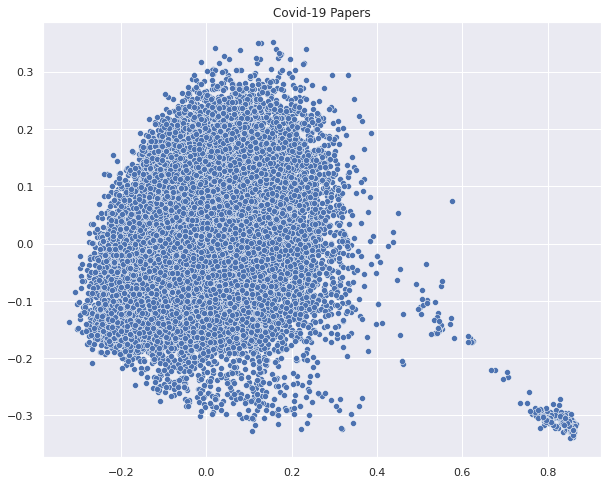

In [191]:
sns.set(rc={'figure.figsize': (10,8)})
sns.scatterplot(X_pca[:,0], X_pca[:, 1])
plt.title('Covid-19 Papers');

## Definição do número de clusters

- Fast K-means: https://www.researchgate.net/publication/51929167_Fast_K-Means_Algorithm_Clustering

In [192]:
from sklearn.cluster import MiniBatchKMeans

Text(0, 0.5, 'WCSS')

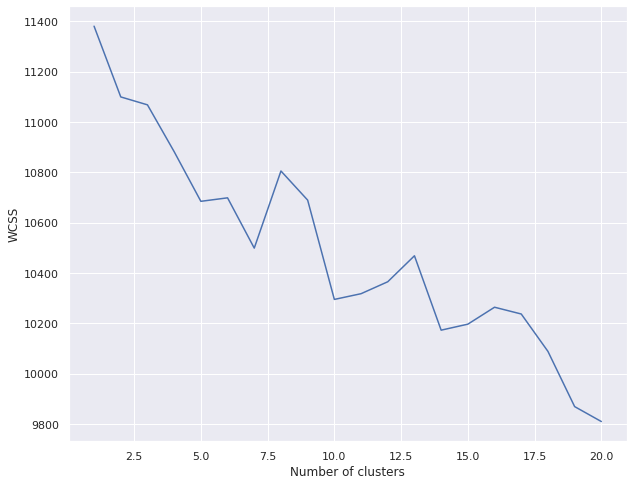

In [193]:
wcss = []
for i in range(1, 21):
  kmeans = MiniBatchKMeans(n_clusters = i, random_state = 0)
  kmeans.fit(vectorized)
  wcss.append(kmeans.inertia_)
plt.plot(range(1, 21), wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')

## Agrupamento com k-means

In [194]:
k = 5
kmeans = MiniBatchKMeans(n_clusters=k)
y_pred = kmeans.fit_predict(vectorized)

In [195]:
np.unique(y_pred)

array([0, 1, 2, 3, 4], dtype=int32)

In [196]:
len(y_pred)

20343

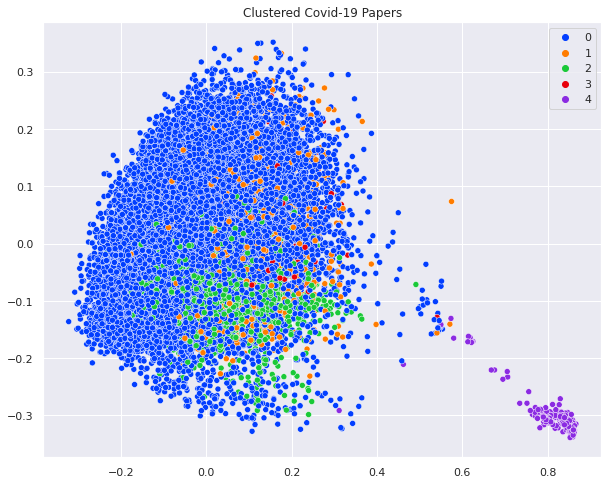

In [197]:
palette = sns.color_palette('bright', len(set(y_pred)))
sns.scatterplot(X_pca[:,0], X_pca[:, 1], hue=y_pred, legend='full', palette=palette)
plt.title('Clustered Covid-19 Papers');

## Visualização dos resultados

In [198]:
# Based on: https://www.kaggle.com/maksimeren/covid-19-literature-clustering

from bokeh.models import ColumnDataSource, HoverTool, LinearColorMapper, CustomJS
from bokeh.palettes import Category20
from bokeh.transform import linear_cmap
from bokeh.io import output_file, show
from bokeh.transform import transform
from bokeh.io import output_notebook
from bokeh.plotting import figure
from bokeh.layouts import column
from bokeh.models import RadioButtonGroup
from bokeh.models import TextInput
from bokeh.layouts import gridplot
from bokeh.models import Div
from bokeh.models import Paragraph
from bokeh.layouts import column, widgetbox

output_notebook()
y_labels = y_pred

# data sources
source = ColumnDataSource(data=dict(
    x= X_pca[:,0], 
    y= X_pca[:,1],
    x_backup = X_pca[:,0],
    y_backup = X_pca[:,1],
    desc= y_labels, 
    titles= corona_df_completo['title'],
    abstract = corona_df_completo['abstract'],
    labels = ["C-" + str(x) for x in y_labels]
    ))

# hover over information
hover = HoverTool(tooltips=[
    ("Title", "@titles{safe}"),
    ("Abstract", "@abstract{safe}"),
],
                 point_policy="follow_mouse")

# map colors
mapper = linear_cmap(field_name='desc', 
                     palette=Category20[20],
                     low=min(y_labels) ,high=max(y_labels))

# prepare the figure
p = figure(plot_width=800, plot_height=800, 
           tools=[hover, 'pan', 'wheel_zoom', 'box_zoom', 'reset'], 
           title="Covid-19 Papers", 
           toolbar_location="right")

# plot
p.scatter('x', 'y', size=5, 
          source=source,
          fill_color=mapper,
          line_alpha=0.3,
          line_color="black",
          legend = 'labels')

# add callback to control 
callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var radio_value = cb_obj.active;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            labels = data['desc'];
            
            if (radio_value == '20') {
                for (i = 0; i < x.length; i++) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                }
            }
            else {
                for (i = 0; i < x.length; i++) {
                    if(labels[i] == radio_value) {
                        x[i] = x_backup[i];
                        y[i] = y_backup[i];
                    } else {
                        x[i] = undefined;
                        y[i] = undefined;
                    }
                }
            }


        source.change.emit();
        """)

# callback for searchbar
keyword_callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var text_value = cb_obj.value;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            abstract = data['abstract'];
            titles = data['titles'];
            
            for (i = 0; i < x.length; i++) {
                if(abstract[i].includes(text_value) || 
                   titles[i].includes(text_value)  {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                } else {
                    x[i] = undefined;
                    y[i] = undefined;
                }
            }
        source.change.emit();
        """)

# option
option = RadioButtonGroup(labels=["C-0", "C-1", "C-2",
                                  "C-3", "C-4", "C-5",
                                  "C-6", "C-7", "C-8",
                                  "C-9", "C-10", "C-11",
                                  "C-12", "C-13", "C-14",
                                  "C-15", "C-16", "C-17",
                                  "C-18", "C-19", "All"], 
                          active=20, callback=callback)

# search box
keyword = TextInput(title="Search:", callback=keyword_callback)

#header
header = Div(text="""<h1>Covid-19 Papers</h1>""")

# show
show(column(header, widgetbox(option, keyword),p))

Loading BokehJS ...

AttributeError: unexpected attribute 'callback' to RadioButtonGroup, similar attributes are js_event_callbacks

# Sumarização dos textos

## Testes com a função

In [ ]:
corona_df_original = pd.read_csv('/content/gdrive/My Drive/corona_df_original.csv')

In [ ]:
corona_df_original.shape

In [ ]:
corona_df_original.head()

In [ ]:
!pip install bert-extractive-summarizer

In [ ]:
from summarizer import Summarizer

In [ ]:
text = str(corona_df_original['text'][0])
print(text)

In [ ]:
len(text)

In [ ]:
model = Summarizer()

In [ ]:
result = model(text)

In [ ]:
result

In [ ]:
result = ''.join(result)
print(result)

In [ ]:
len(result)